<img src="seminarlogo.png" class="center" style="width:100%;"> </img>

# <span style="color:navy"> **Seminar Project:** </span> <span style="color:green"> **Video Coding**</span>

<div style="background-color:#ebeff7; padding:1.25em; border-radius:1em; border: 1px solid black">

### <span style = "color: navy"> **General Procedure:** </span>
1. Make group of $2$ or $3$ students while coordinating with each other and select one group coordinator.
2. Select one the techniques (MDCT or Lapped Transform)
4. Send us the the selected task (technique) and the list of group members with their <b>a)</b> Matriculation Numbers <b>b)</b> email IDs, and highlighting the group coordinator. Make it in a **table** form.
5. The duration of the seminar project is from **11.06.2024** to **31.07.2024**, with a mid-term meeting with each group from *01.07.2024 to 06.07.2024* (Book an appointment at your convenience)
6. There will be a report at the end of project. The submission date for the report is **31.07.2024**
7. The report and results presentation will held from *01.08.2024 to 15.08.2024* (The specific date for each group will be selected after mutual consensus)


<span style="color:blue"> Note: Further Instructions and procedures may be updated from time to time</span>
    
</div>

## <span style = "color: navy"> **Introduction:** </span>
There are two seminar projects, with the aim to compress the given images (Only use the given image in the base repository). The projects are:
<br>
### **Project-1:** <span style = "color: green"> Image-Compression using MDCT </span>
### **Project-2:** <span style = "color: green"> Image-Compression using Lapped Transform </span>

The projects are team-based work with a group of **2** (minimum) to **3** (maximum) students. You (as a team) are required to select one project and implement the technique (either *MDCT* or *Lapped* Transform). <span style = "color: red">To make a balance in project selection, we can assign either Project-1 or Project-2 to any group.</span>

### <span style = "color: navy"> GET STARTED </span>
The basic building blocks (base algorithm and/or material) of the Projects are provided in the git-repository (https://github.com/Karanraj06/image-compression).
In this repository, the implementation of image compression is done by using simple **DCT** which you can take as your staring point and further develop or modify this base-repository according to the selected project i.e. techniques (*MDCT* or *Lapped* Transform) of selected project.

### <span style = "color: navy"> Project Tasks </span>
1. Take the base repository as base or reference
2. Modify the DCT part with your selected technique (either MDCT or Lapped Transform)
    - For the "MDCT" you need to find out the optimum window, try different windows
    - The "lapped transform" needs to be implemented by Pytorch's Conv2D. For that, the kernel size can be chosen like the MDCT, which is 16x16. In order to get good transform filters, it needs to be trained, and for that you need to use the images in the image coder repository.
5. Compare the results of compression of your modified version with the reference, which is DCT, by using Perceptual Similarity Metric and compression ratio. The repository for Perceptual Similarity Metric measurement is given here (https://github.com/richzhang/PerceptualSimilarity)
6. The expected calculations among others should include the results of "bits per pixel"

### <span style = "color: navy"> Some use full links </span>
1. https://github.com/TUIlmenauAMS/Python-Audio-Coder
2. https://pytorch.org/docs/stable/generated/torch.nn.Conv2d.html

##### <span style="color:blue"> Further details will be discussed with the group coordinators and the they are responsible for group coordination</span>

<div style="background-color:#ebeff7; padding:1.25em; border-radius:1em; border: 1px solid black">

### <span style="color:navy; font-size: 1.25em"> **Project:** </span>
#### <span style="color:blue"> Below Enter Matriculation Numbers of each member </span>

</div>

In [ ]:
MatriculationNumber = '64494, 65862, 65374'; # Example

In [24]:
!git clone https://github.com/M-B-Hussain/Image-Compression-using-MDCT.git 
%cd Image-Compression-using-MDCT
#the whole report is saved in our git repository, you can clone the repo and download the file named with "VC_Report.pdf" 
#Thank you

fatal: destination path 'Image-Compression-using-MDCT' already exists and is not an empty directory.
/home/jupyter-64494/VC_Seminar_Project/Image-Compression-using-MDCT


/opt/tljh/user/lib/python3.10/site-packages/IPython/core/magics/osm.py:417: UserWarning: using dhist requires you to install the `pickleshare` library.
  self.shell.db['dhist'] = compress_dhist(dhist)[-100:]


### <span style="color:navy; font-size: 1.25em"> **Description:**</span>
Place to describe the task, procedure, results etc. (delete this line when writting)

In [ ]:
TASK#1

In [15]:
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
import os
currdir = os.getcwd()

In [16]:
def mdct(x):
    """Compute the MDCT of the 1D input array x."""
    N = len(x)
    n0 = (N + 1) / 2
    X = np.zeros(N//2)

    for k in range(N//2):
        X[k] = np.sum([
            x[n] * np.cos(np.pi / N * (n + n0) * (2 * k + 1))
            for n in range(N)
        ])
    
    return X

In [17]:
def imdct(X):
    """Compute the IMDCT of the 1D input array X."""
    N = 2 * len(X)
    n0 = (N + 1) / 2
    x = np.zeros(N)

    for n in range(N):
        x[n] = np.sum([
            X[k] * np.cos(np.pi / N * (n + n0) * (2 * k + 1))
            for k in range(len(X))
        ])
    
    return x / (N / 2)  # Normalization factor

In [18]:
def mdct2d(block):
    """Apply MDCT to each row and then each column of the block."""
    return np.apply_along_axis(mdct, 0, np.apply_along_axis(mdct, 1, block))

def imdct2d(block):
    """Apply IMDCT to each column and then each row of the block."""
    return np.apply_along_axis(imdct, 0, np.apply_along_axis(imdct, 1, block))

In [19]:
def display_images(original_image, compressed_image, title):
    plt.figure(figsize=(12, 6))
    plt.subplot(121)
    plt.imshow(original_image)
    plt.title('Original Image')
    plt.axis('off')

    plt.subplot(122)
    plt.imshow(compressed_image)
    plt.title(f'Compressed Image\n{title}')
    plt.axis('off')

    plt.tight_layout()
    plt.show()

In [20]:
def process_image(input_path, output_path, block_size=8):
    image = Image.open(input_path)
    image_data = np.array(image)
    h, w, c = image_data.shape

    processed_data = np.zeros_like(image_data)

    for channel in range(c):
        for i in range(0, h - block_size + 1, block_size):
            for j in range(0, w - block_size + 1, block_size):
                block = image_data[i:i+block_size, j:j+block_size, channel]

                # Apply 2D MDCT to the block
                mdct_block = mdct2d(block)

                # Apply 2D IMDCT to reconstruct the block
                reconstructed_block = imdct2d(mdct_block)

                # Store the reconstructed block in the processed data array
                processed_data[i:i+block_size, j:j+block_size, channel] = np.round(reconstructed_block)

    # Clip values to be in the valid range [0, 255]
    processed_data = np.clip(processed_data, 0, 255).astype(np.uint8)

    # Create the output image
    output_image = Image.fromarray(processed_data)
    output_image.save(output_path)

    # Display the original and compressed images
    display_images(image, output_image, f'Block Size: {block_size}')

In [21]:

def process_images_in_directory(input_directory, output_directory, block_size_list):
    for filename in os.listdir(input_directory):
        if filename.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp')):
            input_image_path = os.path.join(input_directory, filename)
            for block_size in block_size_list:
                output_image_path = os.path.join(output_directory, f'{filename}_block_size_{block_size}.jpeg')
                print(f'Processing {filename} with block size {block_size}...')
                process_image(input_image_path, output_image_path, block_size)

Processing 7.png with block size 4...


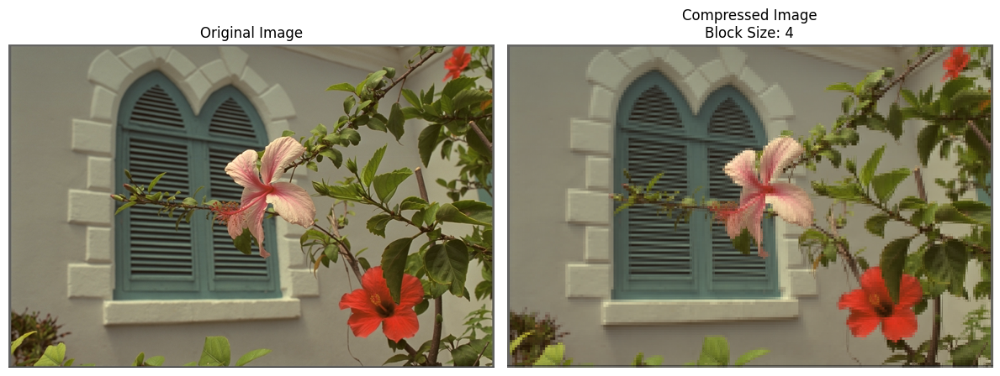

Processing 7.png with block size 8...


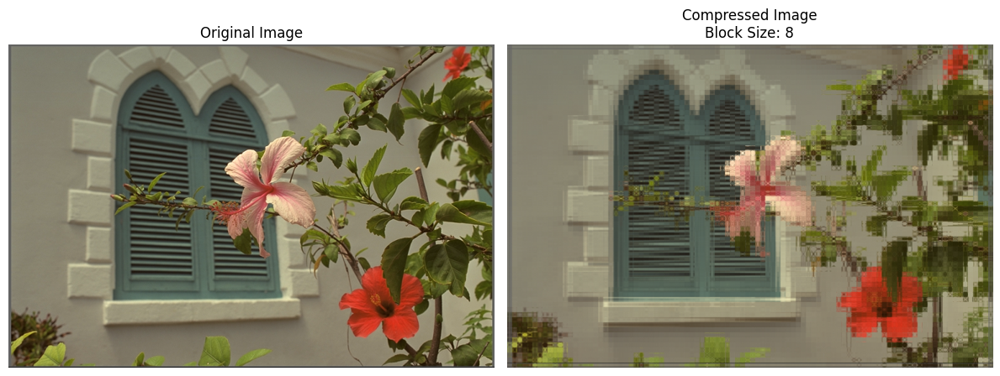

Processing 7.png with block size 16...


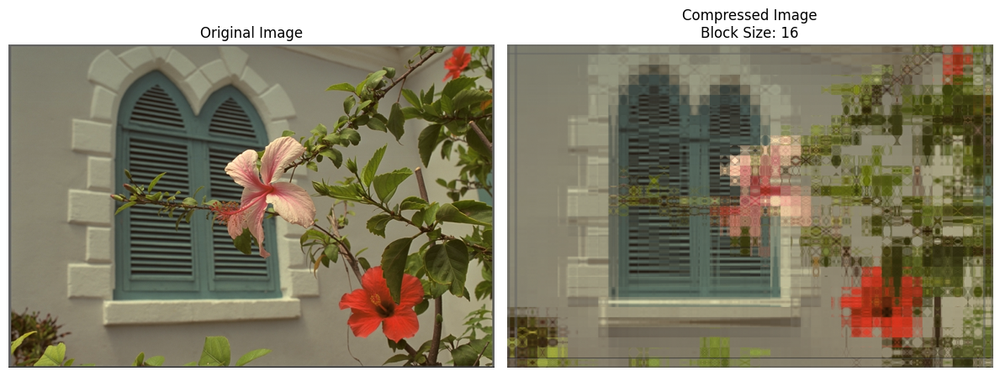

Processing 22.png with block size 4...


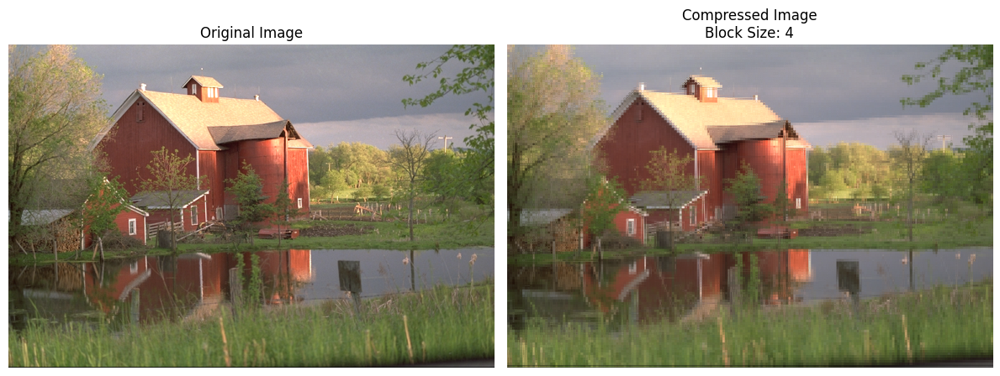

Processing 22.png with block size 8...


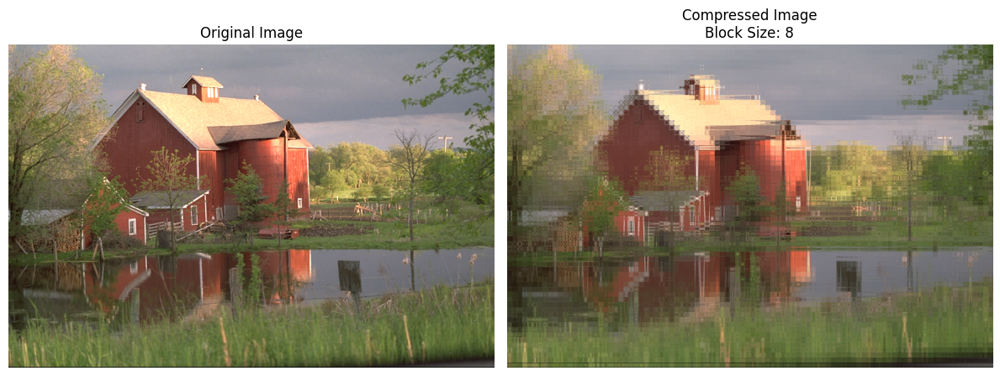

Processing 22.png with block size 16...


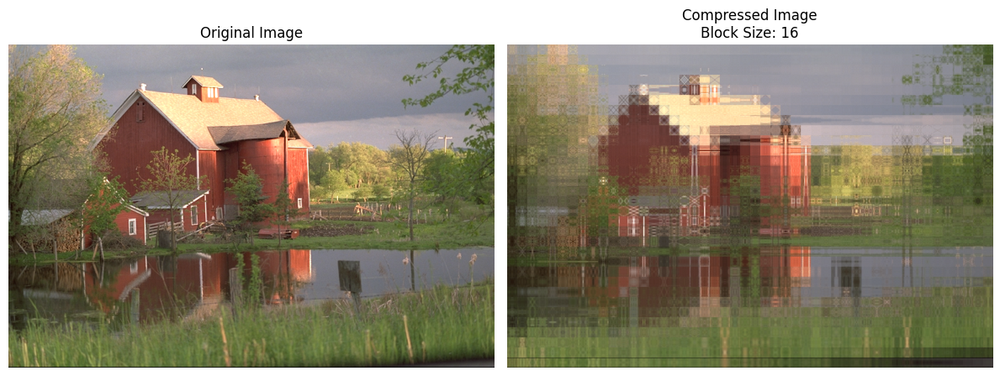

Processing 13.png with block size 4...


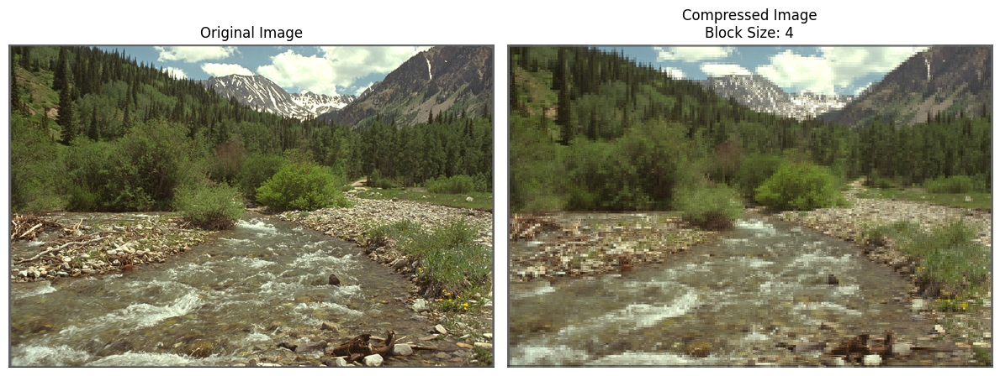

Processing 13.png with block size 8...


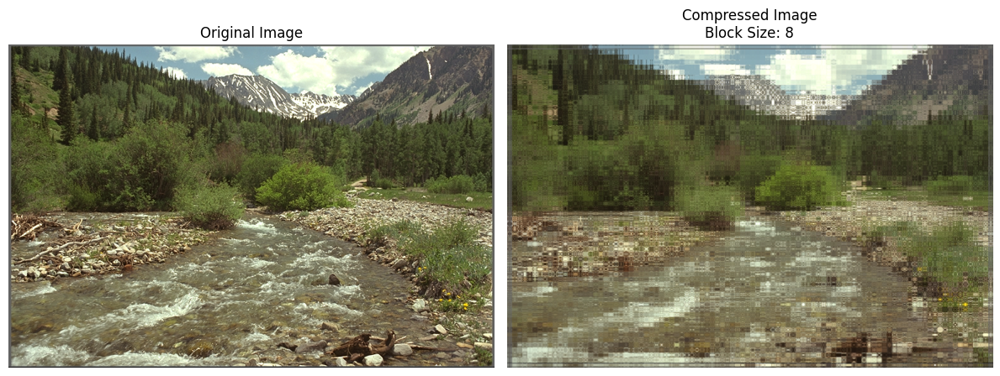

Processing 13.png with block size 16...


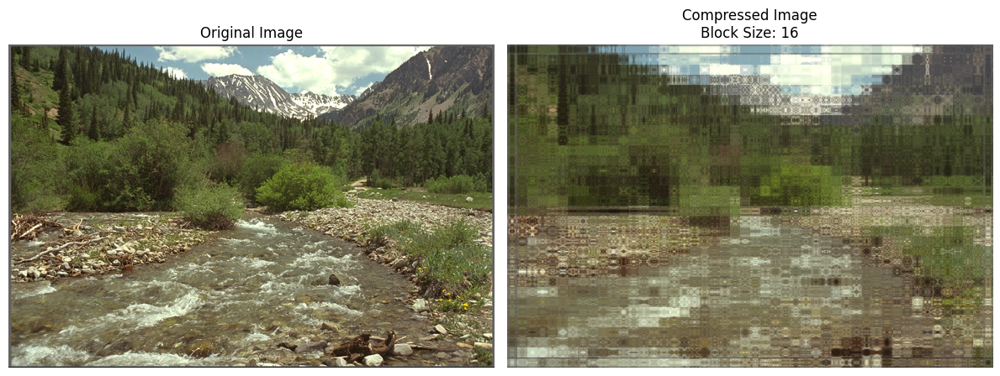

Processing 21.png with block size 4...


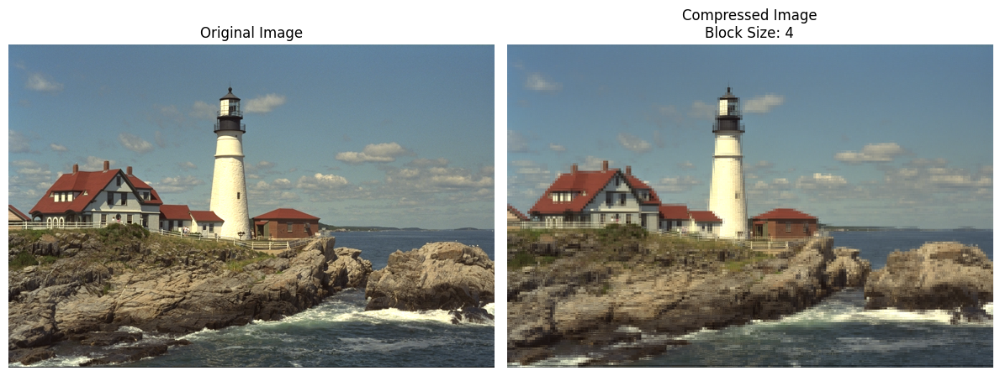

Processing 21.png with block size 8...


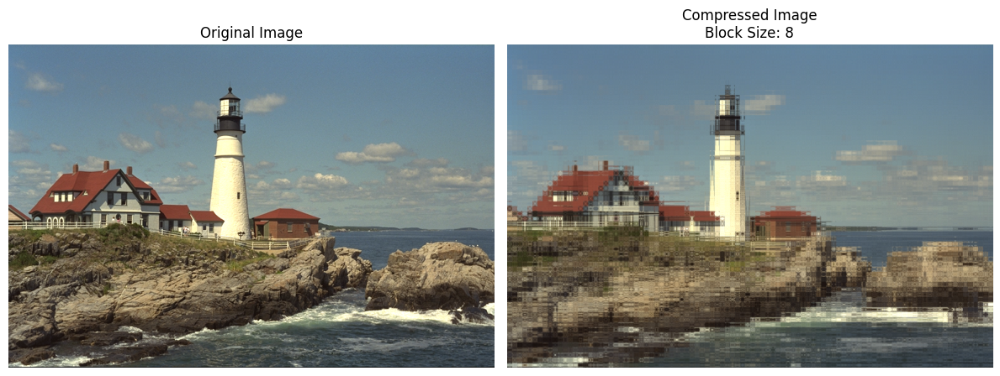

Processing 21.png with block size 16...


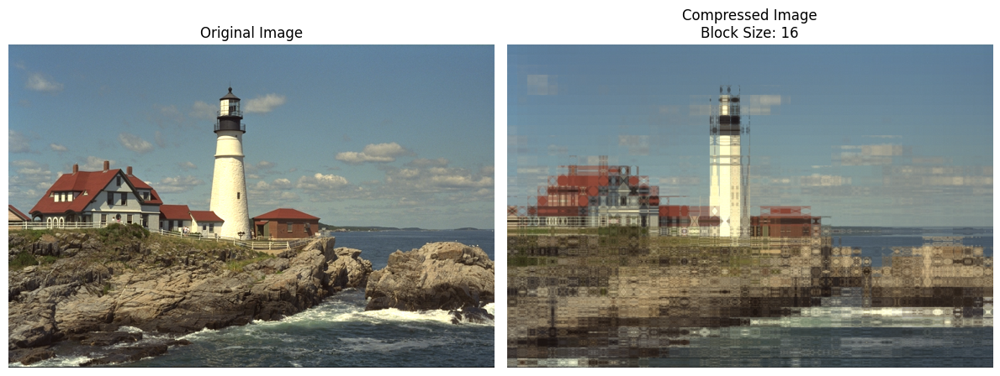

Processing 16.png with block size 4...


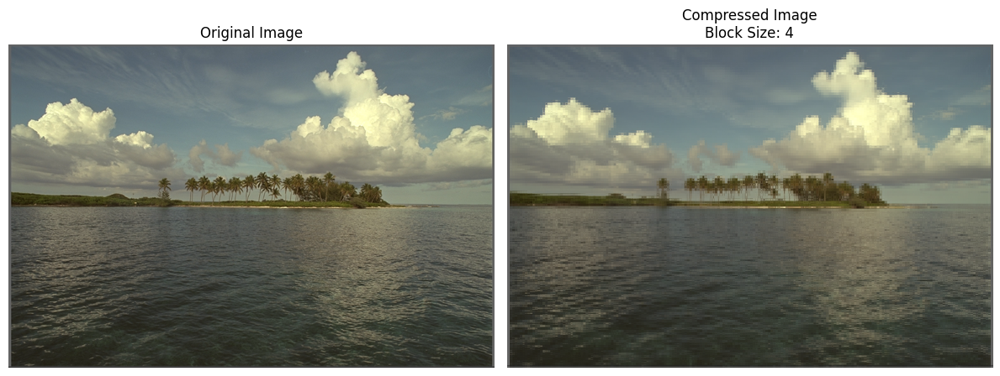

Processing 16.png with block size 8...


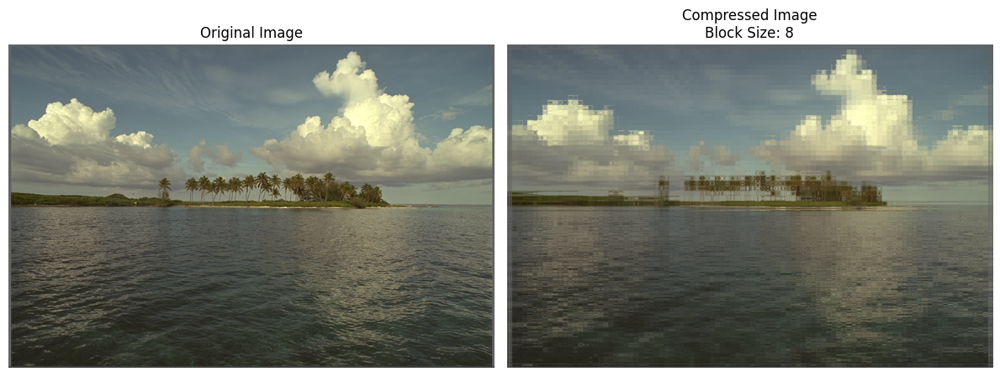

Processing 16.png with block size 16...


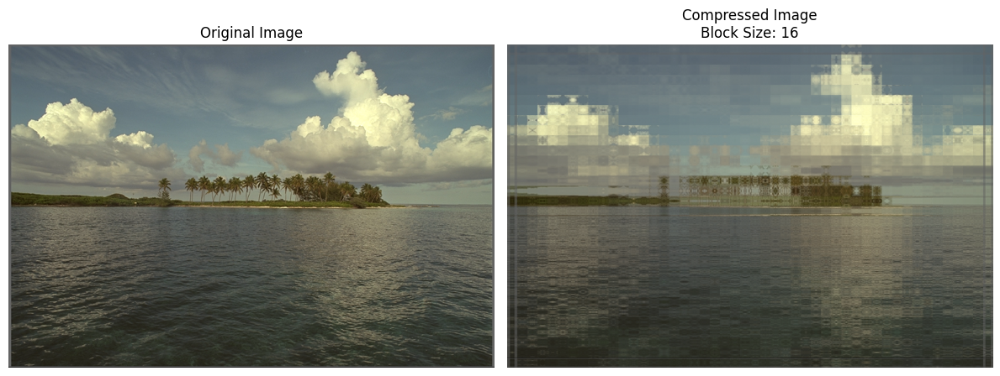

Processing 3.png with block size 4...


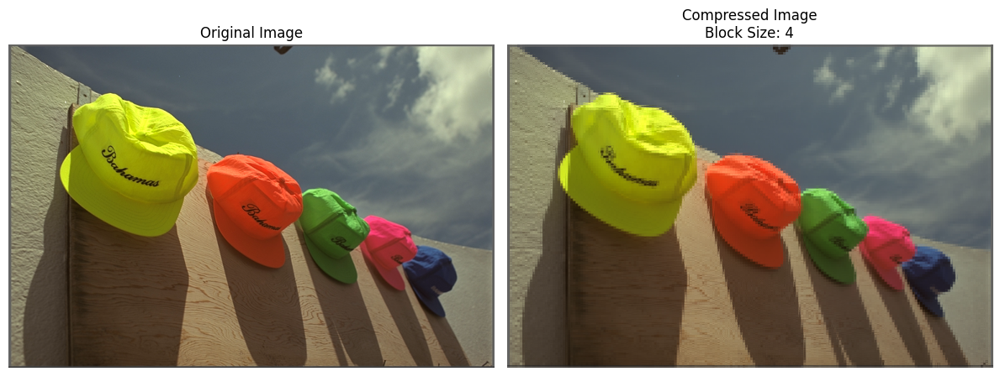

Processing 3.png with block size 8...


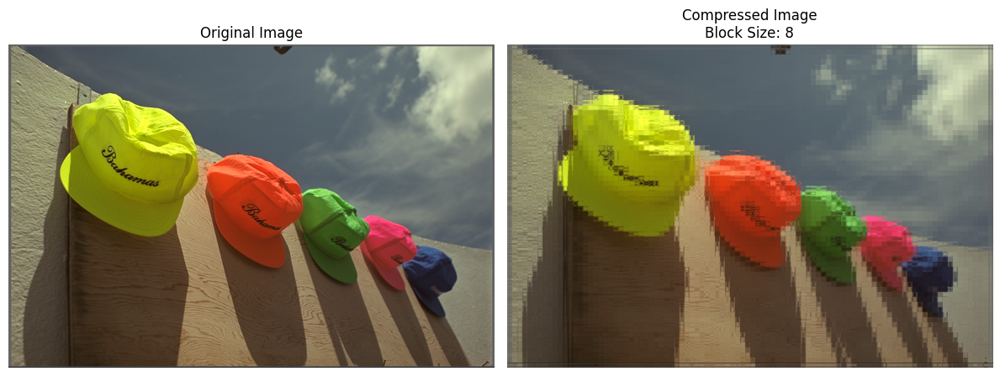

Processing 3.png with block size 16...


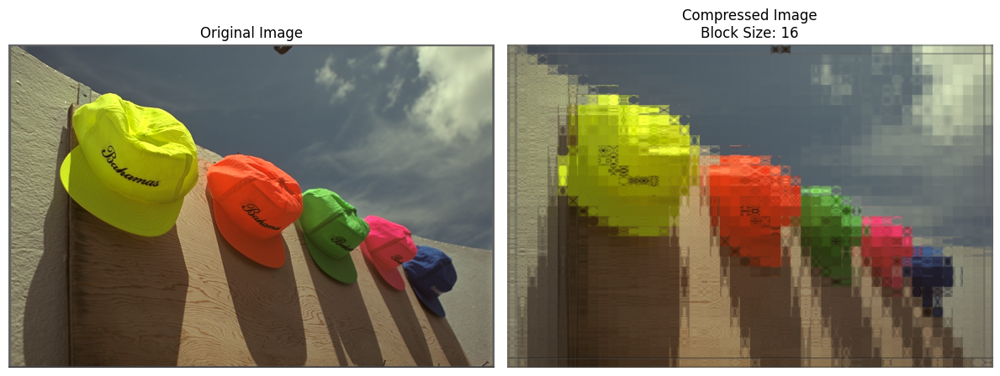

Processing 19.png with block size 4...


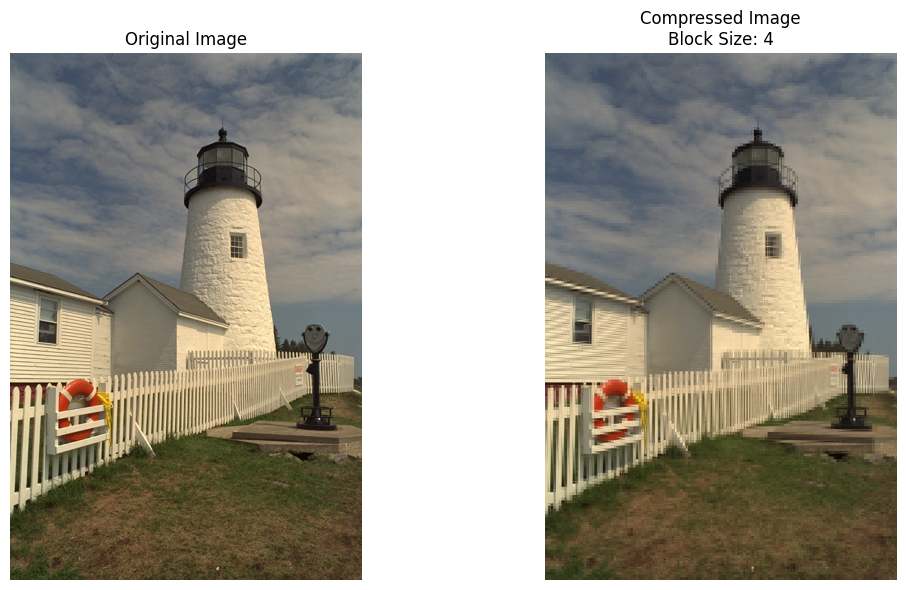

Processing 19.png with block size 8...


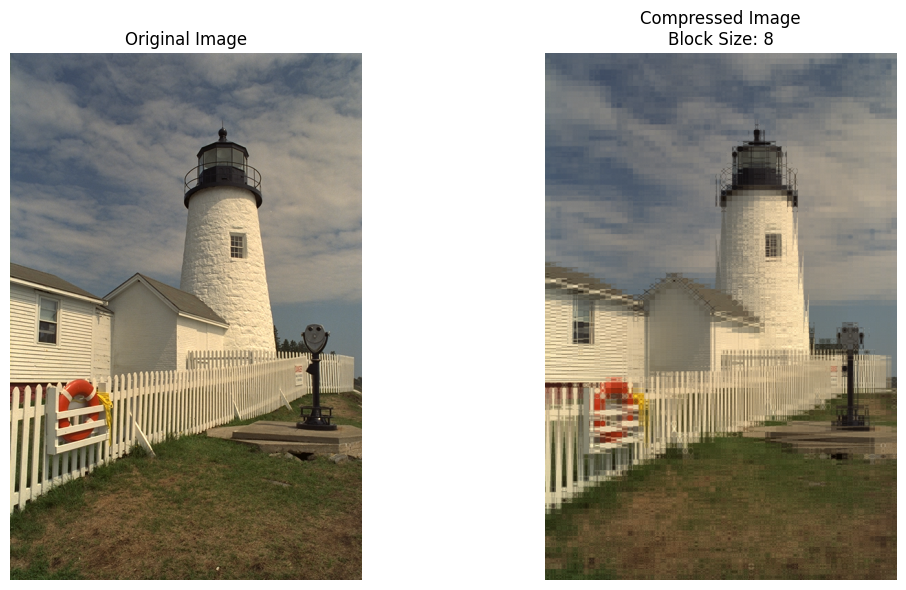

Processing 19.png with block size 16...


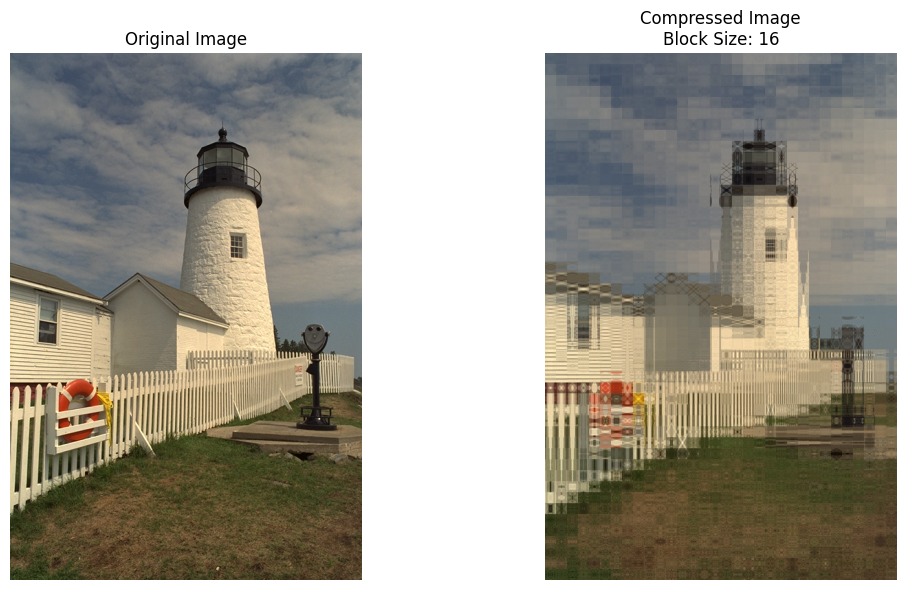

Processing 4.png with block size 4...


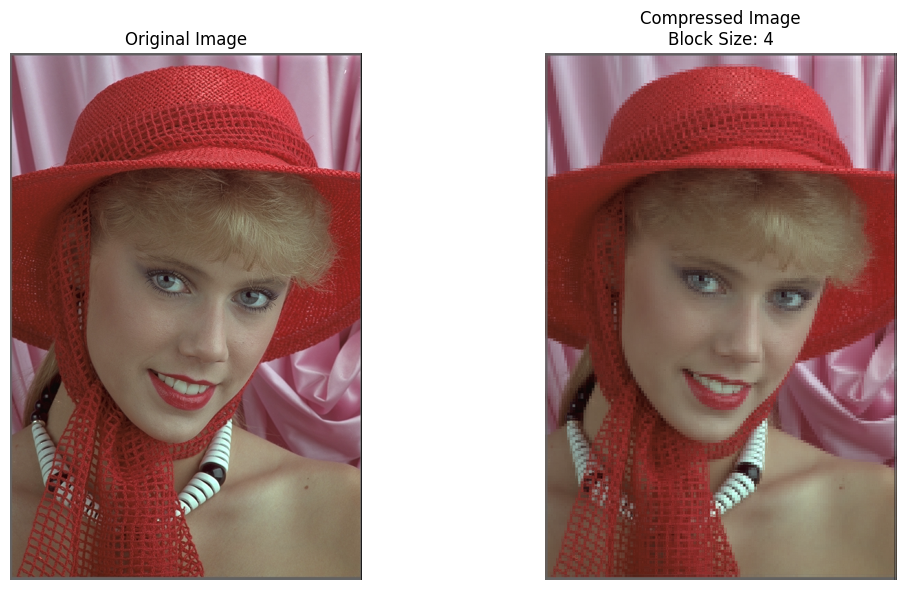

Processing 4.png with block size 8...


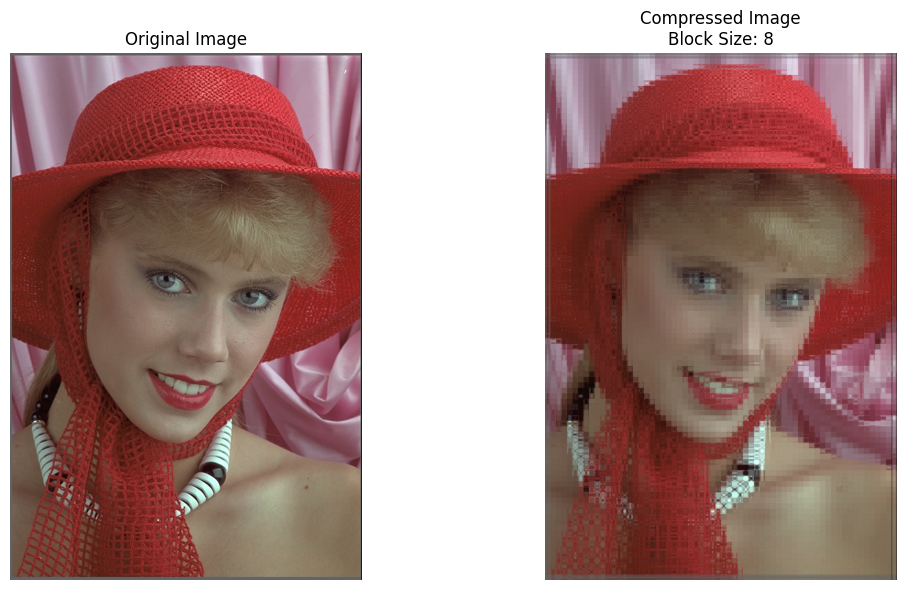

Processing 4.png with block size 16...


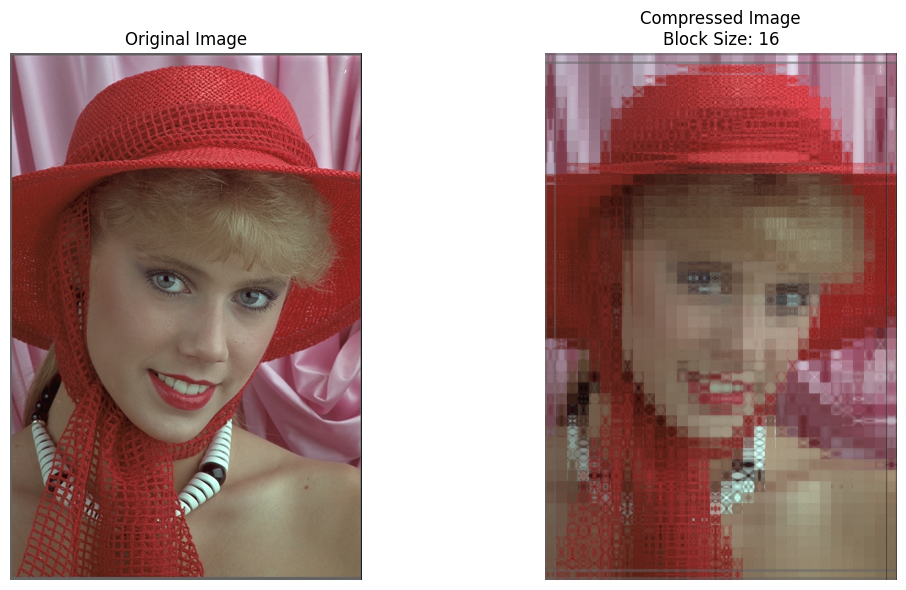

Processing 6.png with block size 4...


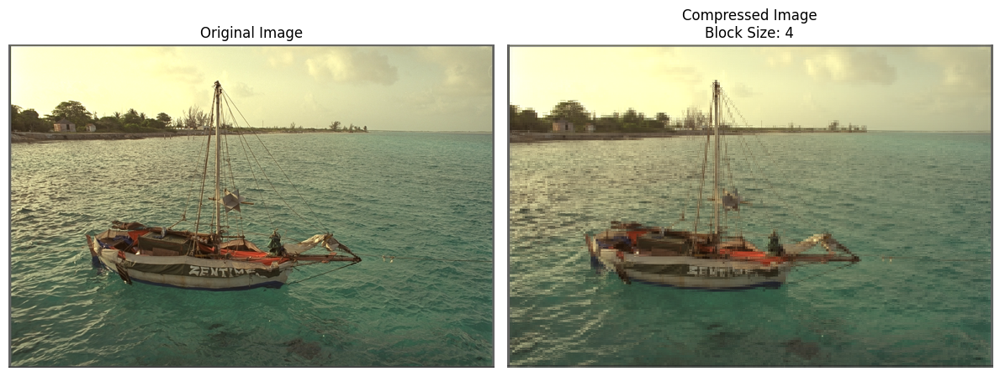

Processing 6.png with block size 8...


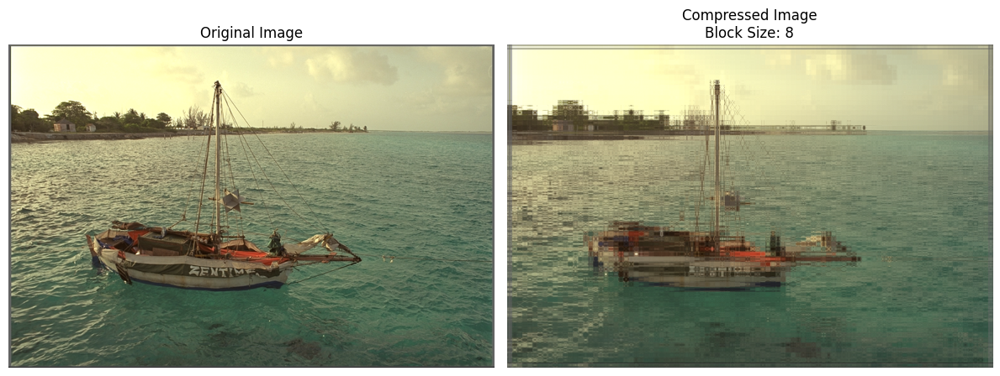

Processing 6.png with block size 16...


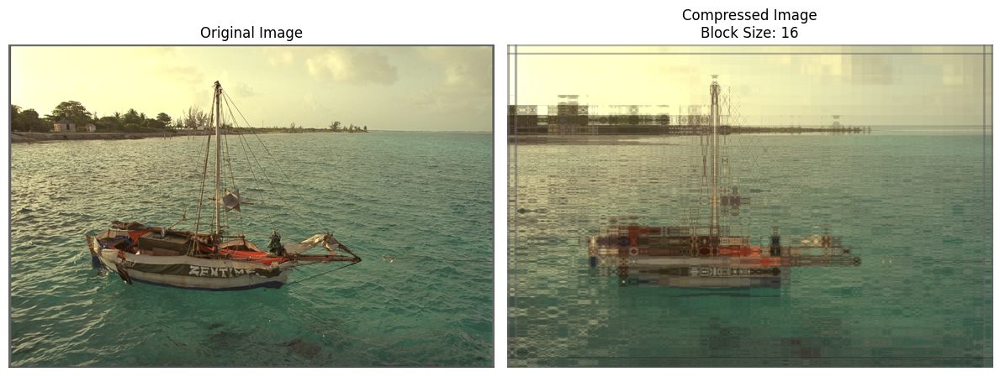

Processing 9.png with block size 4...


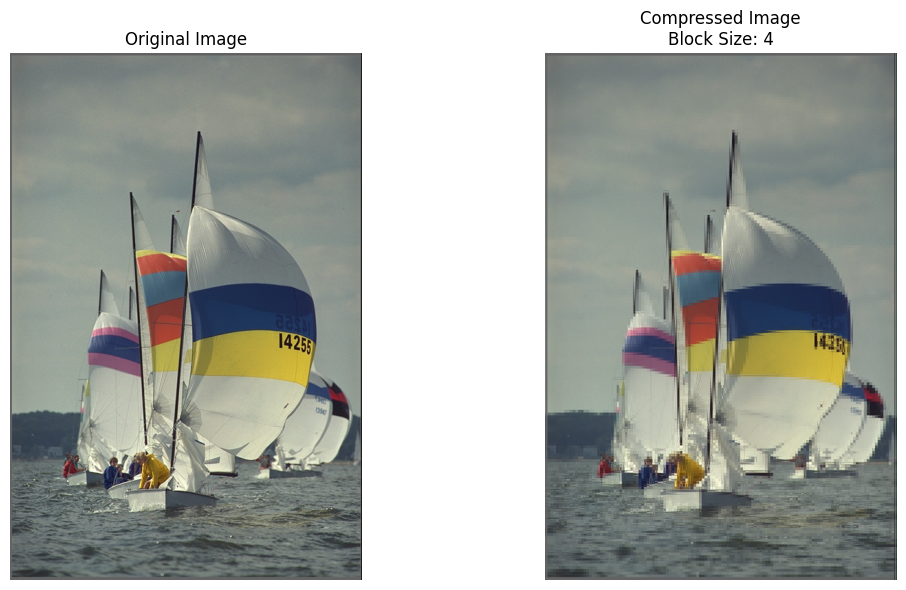

Processing 9.png with block size 8...


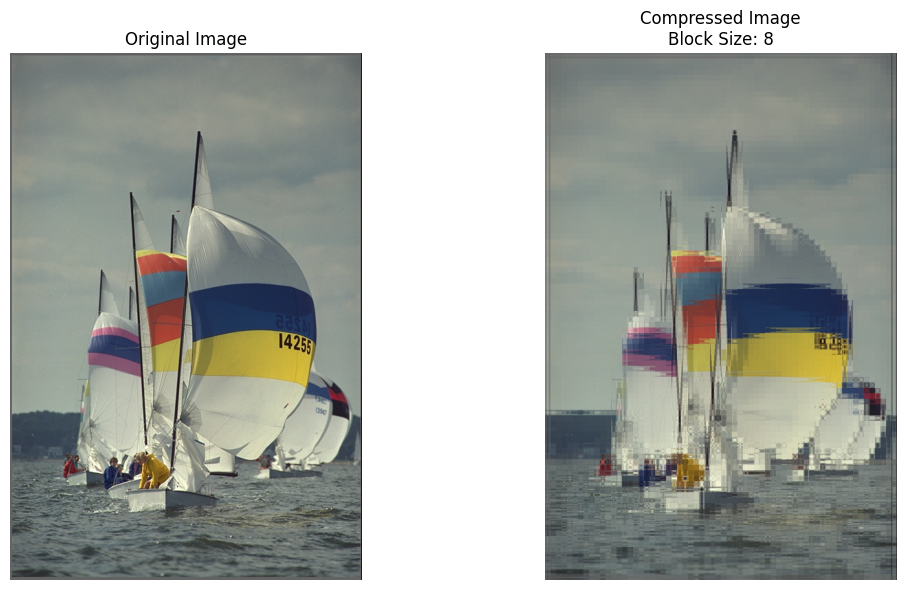

Processing 9.png with block size 16...


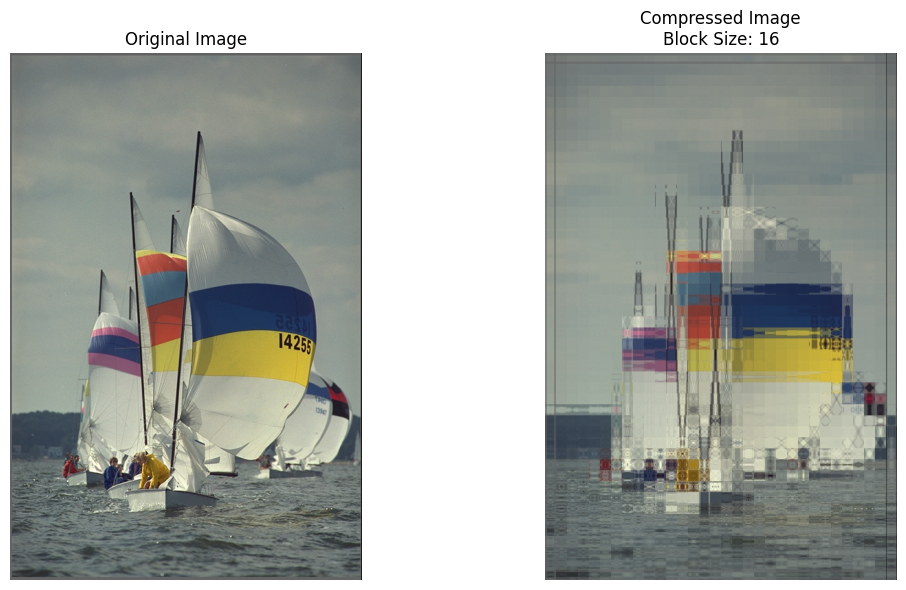

Processing 23.png with block size 4...


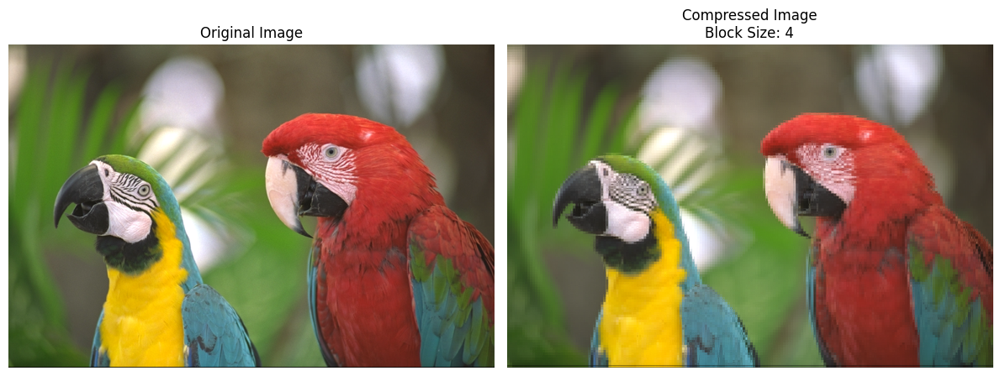

Processing 23.png with block size 8...


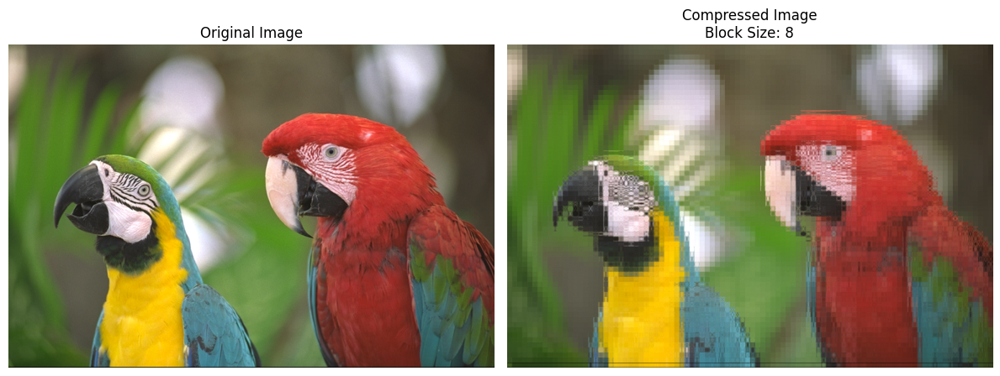

Processing 23.png with block size 16...


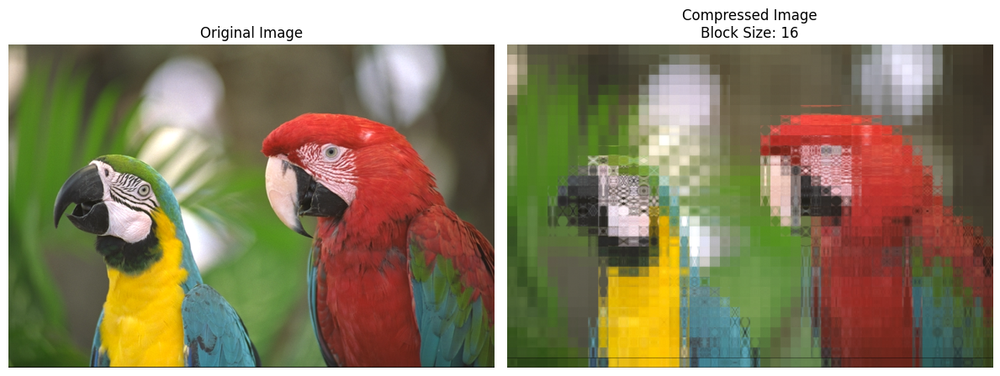

Processing 5.png with block size 4...


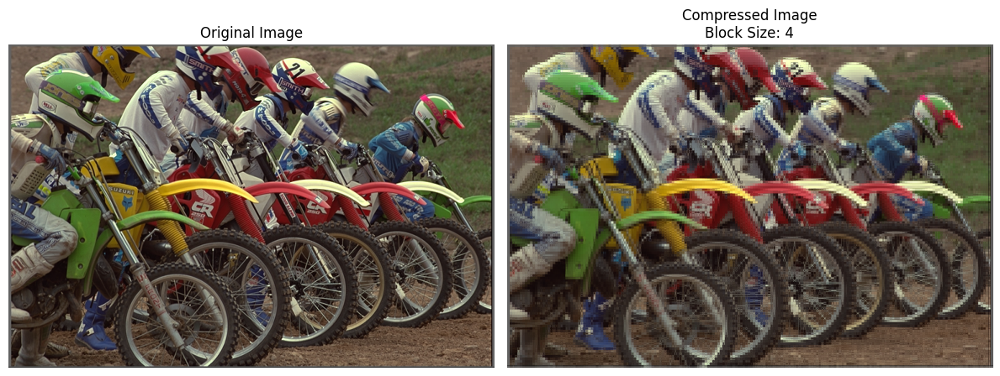

Processing 5.png with block size 8...


KeyboardInterrupt: 

In [23]:
if __name__ == "__main__":
    input_directory = os.getcwd() + '/input_images'  # Replace with your input image directory
    output_directory = os.getcwd() + '/output_images'  # Replace with your output image directory
    block_size_list = [4, 8, 16]  # Example block sizes
    process_images_in_directory(input_directory, output_directory, block_size_list)

### <span style="color:blue"> END Report here </span>